In [9]:
import numpy as np
import pandas as pd
import os
import censusgeocode
import matplotlib.pyplot as plt
import sys
from importlib import reload

sys.path.append("../")

from geotiff_tiling import extractor

In [3]:
cg = censusgeocode.CensusGeocode(benchmark='Public_AR_Census2010', vintage='Census2010_Census2010')
result = cg.coordinates(x=-83.68230793774812, y=42.20452174575431)
# result

In [4]:
DIRPATH = '/Volumes/Cooper_TB_Drive/research/readmissions/demographic_data/Census Data/Income/'

for file in os.listdir(DIRPATH):
    print(file)


Income_Data_2015.csv
Income_Data_2018.csv
Income_Metadata_2015.csv
Income_Metadata_2018.csv
Income_readme_2015.txt
Income_readme_2018.txt


In [5]:
FPATH = f"{DIRPATH}Income_Data_2015.csv"
df = pd.read_csv(FPATH)
# df.columns = df.iloc[0]
df = df.iloc[1:].reset_index()
print(df.shape)
df.head()

(1416, 123)


,index,GEO_ID,NAME,S1903_C01_001E,S1903_C01_001M,S1903_C01_002E,S1903_C01_002M,S1903_C01_003E,S1903_C01_003M,S1903_C01_004E,...,S1903_C02_026E,S1903_C02_026M,S1903_C02_027E,S1903_C02_027M,S1903_C02_028E,S1903_C02_028M,S1903_C02_029E,S1903_C02_029M,S1903_C02_030E,S1903_C02_030M
0,1,1400000US26093710100,"Census Tract 7101, Livingston County, Michigan",844,38,97.5,1.7,1.1,1.2,0.0,...,(X),(X),(X),(X),(X),(X),(X),(X),(X),(X)
1,2,1400000US26093710300,"Census Tract 7103, Livingston County, Michigan",1344,85,96.0,3.8,0.8,1.2,0.0,...,(X),(X),(X),(X),(X),(X),(X),(X),(X),(X)
2,3,1400000US26093710500,"Census Tract 7105, Livingston County, Michigan",638,49,96.1,4.1,0.0,3.5,1.1,...,36042,15969,-,**,(X),(X),(X),(X),(X),(X)
3,4,1400000US26093710700,"Census Tract 7107, Livingston County, Michigan",631,34,98.9,1.7,0.0,3.5,0.0,...,(X),(X),(X),(X),(X),(X),(X),(X),(X),(X)
4,5,1400000US26093711000,"Census Tract 7110, Livingston County, Michigan",1538,97,95.8,2.9,0.5,0.8,0.0,...,40455,35605,-,**,(X),(X),(X),(X),(X),(X)


shape 1 (1416, 3)
shape 2 (1395, 3)
shape 3 (1394, 3)
MAX MEDIAN INCOME:
index                               1360
Median Household Income           177829
Census Tract                        5613
County                      Wayne County
State                           Michigan
Name: 1338, dtype: object

MIN MEDIAN INCOME:
index                               1121
Median Household Income             9458
Census Tract                        5223
County                      Wayne County
State                           Michigan
Name: 1109, dtype: object



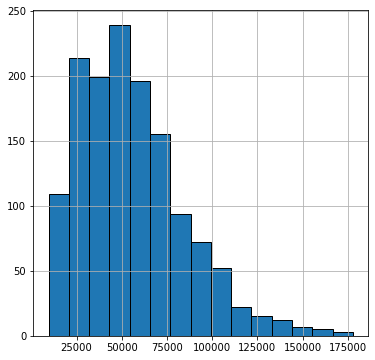

In [6]:
"""
This column is median income for households: S1903_C02_001E
"""

tmp = df[['GEO_ID', 'NAME', 'S1903_C02_001E']]
print(f"shape 1 {tmp.shape}")
tmp = tmp[tmp['S1903_C02_001E'] != "-"]
print(f"shape 2 {tmp.shape}")
tmp = tmp[tmp['S1903_C02_001E'] != "(X)"]
print(f"shape 3 {tmp.shape}")

tmp['S1903_C02_001E'] = tmp['S1903_C02_001E'].astype(float)

tmp[['Census Tract', 'County', 'State']] = tmp['NAME'].str.split(',',expand=True)
tmp['Census Tract'] = tmp['Census Tract'].str.replace("Census Tract", "").astype(float) 
tmp = tmp.rename(columns={'S1903_C02_001E': 'Median Household Income'})
tmp = tmp[['Median Household Income', 'Census Tract', 'County', 'State']] 
tmp = tmp.reset_index()

print(f"MAX MEDIAN INCOME:")
print(tmp.iloc[tmp['Median Household Income'].idxmax()])
print()

print(f"MIN MEDIAN INCOME:")
print(tmp.iloc[tmp['Median Household Income'].idxmin()])
print()

tmp['Median Household Income'].hist(figsize=(6,6), bins=15, edgecolor='black')
plt.show()

# tmp.head()



In [8]:
df.head()

,index,GEO_ID,NAME,S1903_C01_001E,S1903_C01_001M,S1903_C01_002E,S1903_C01_002M,S1903_C01_003E,S1903_C01_003M,S1903_C01_004E,...,S1903_C02_026E,S1903_C02_026M,S1903_C02_027E,S1903_C02_027M,S1903_C02_028E,S1903_C02_028M,S1903_C02_029E,S1903_C02_029M,S1903_C02_030E,S1903_C02_030M
0,1,1400000US26093710100,"Census Tract 7101, Livingston County, Michigan",844,38,97.5,1.7,1.1,1.2,0.0,...,(X),(X),(X),(X),(X),(X),(X),(X),(X),(X)
1,2,1400000US26093710300,"Census Tract 7103, Livingston County, Michigan",1344,85,96.0,3.8,0.8,1.2,0.0,...,(X),(X),(X),(X),(X),(X),(X),(X),(X),(X)
2,3,1400000US26093710500,"Census Tract 7105, Livingston County, Michigan",638,49,96.1,4.1,0.0,3.5,1.1,...,36042,15969,-,**,(X),(X),(X),(X),(X),(X)
3,4,1400000US26093710700,"Census Tract 7107, Livingston County, Michigan",631,34,98.9,1.7,0.0,3.5,0.0,...,(X),(X),(X),(X),(X),(X),(X),(X),(X),(X)
4,5,1400000US26093711000,"Census Tract 7110, Livingston County, Michigan",1538,97,95.8,2.9,0.5,0.8,0.0,...,40455,35605,-,**,(X),(X),(X),(X),(X),(X)


/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/7_Oakland_tiles.npy
(1000, 3, 1000, 1000)


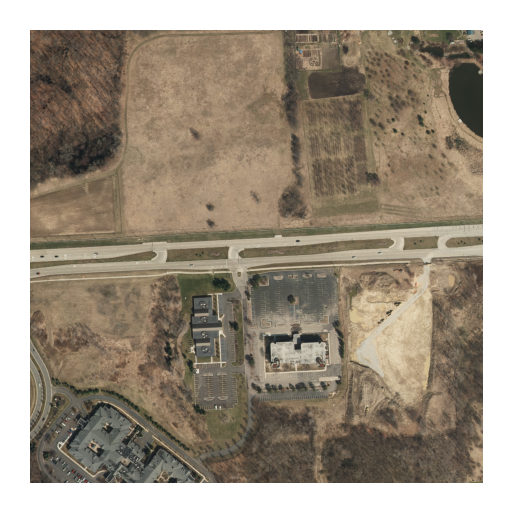

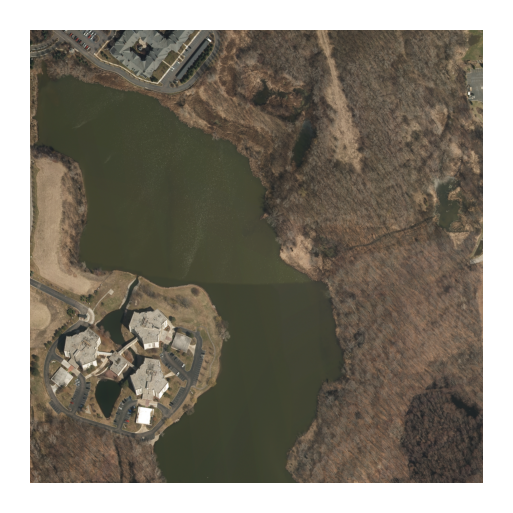

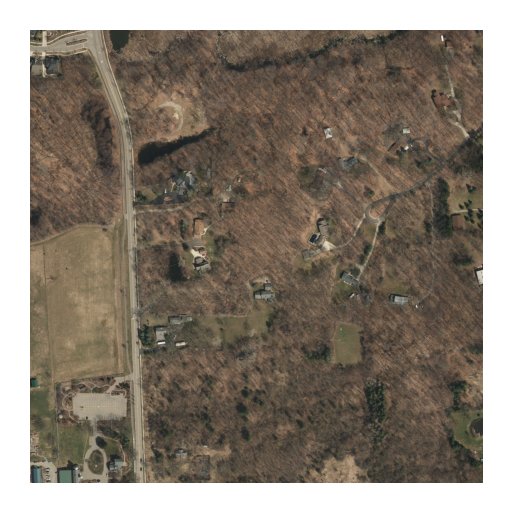

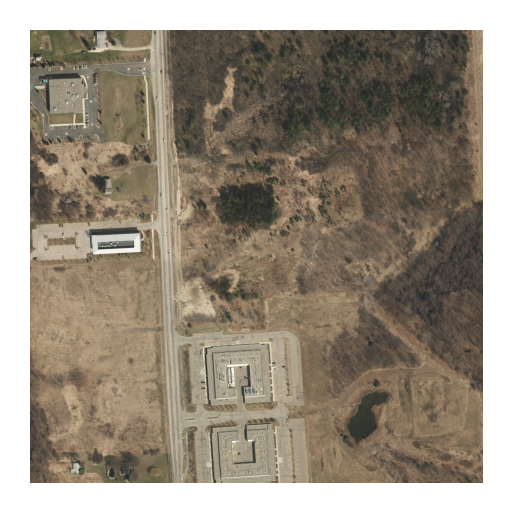

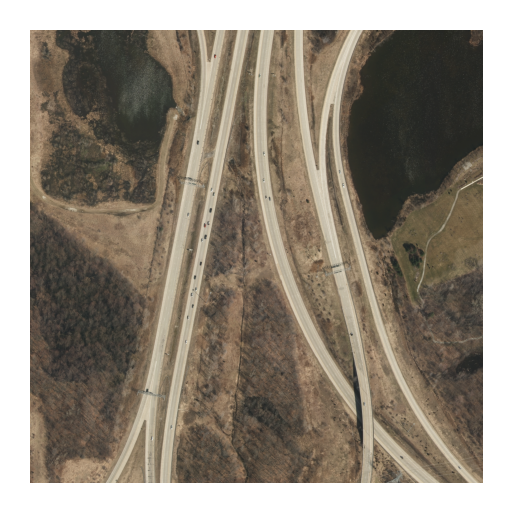

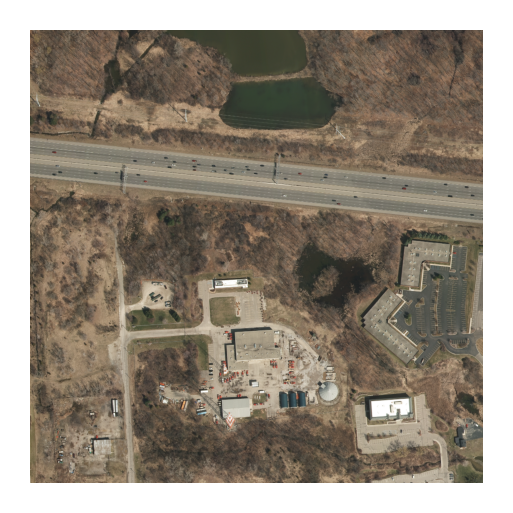

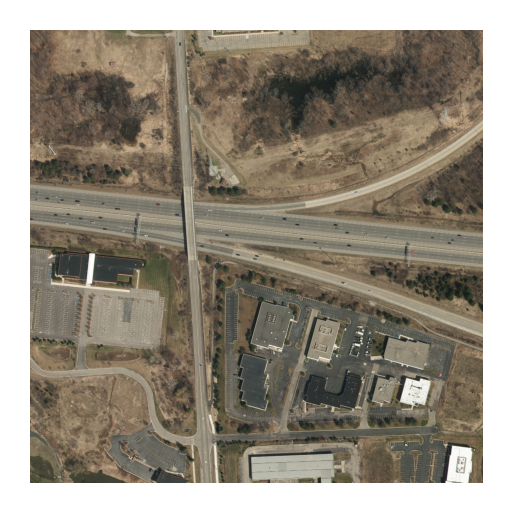

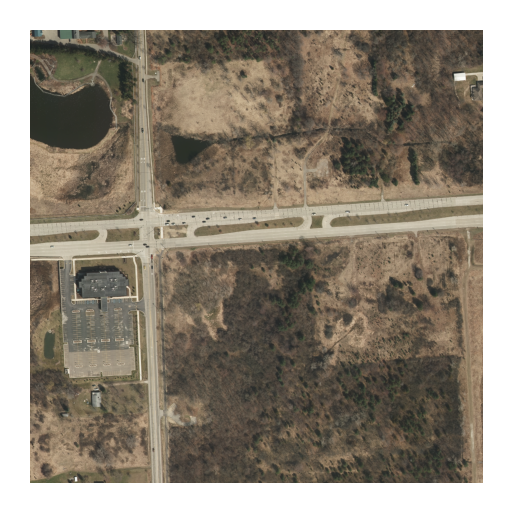

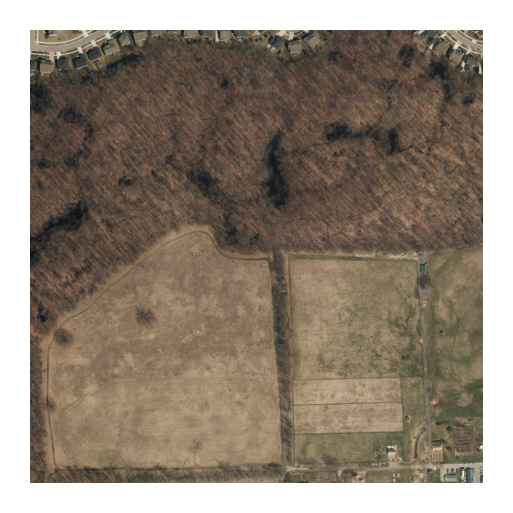

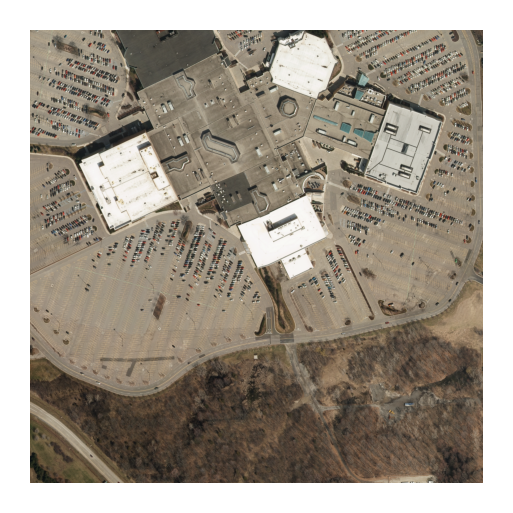

In [53]:
reload(extractor)

"""
richest median census tract
"""

LAT = 42.491517
LON = -83.458524
K = 10 # number of closest images

twelve_oaks_extract = extractor.Extractor()
results = twelve_oaks_extract.find_closest_latlon(lat=LAT, lon=LON, k=K)
# print(results.T)

for i, res in results.iterrows():
    res_tile = twelve_oaks_extract.tile_getter(res['county'], res['chunk_file'])

    print(res_tile.shape)

    img_to_chunk_index = int(str(res['image_index'])[1:]) 
    img = res_tile[img_to_chunk_index, :, :, :]
    twelve_oaks_extract.plot_image(img)
    county = str(res['county'])
    savepath = f'example_images/{i}_{county}.png'
    plt.savefig(savepath)

/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/3_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/2_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/3_Wayne_tiles.npy
(1000, 3, 1000, 1000)
/Volumes/Cooper_TB_Drive/research/readmissions/tile_files/3_Wayne_tiles.npy
(1000, 3, 1000, 1000)


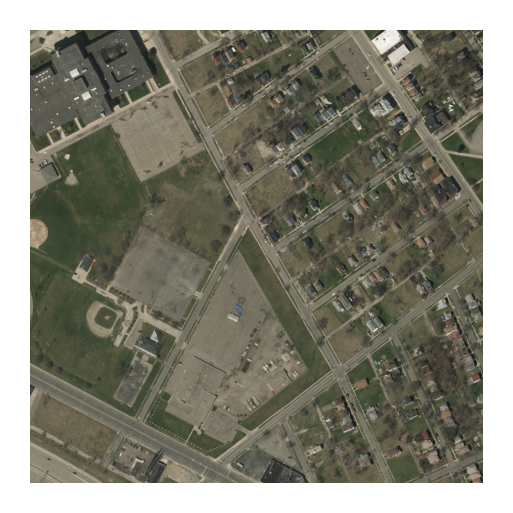

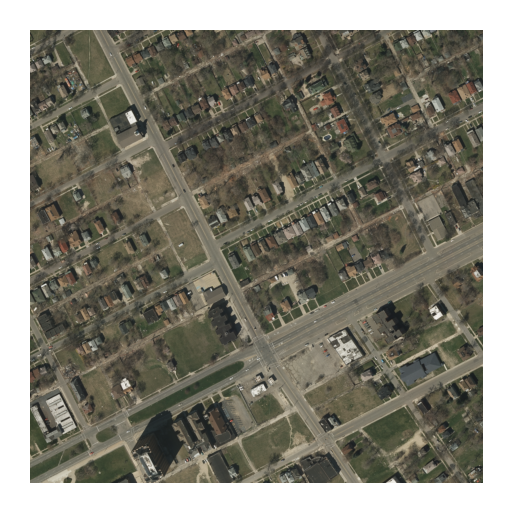

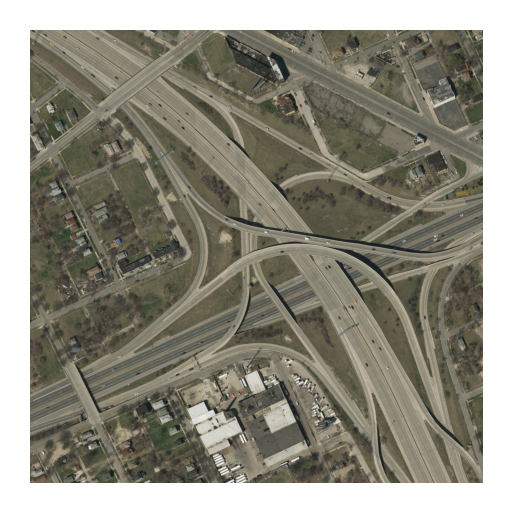

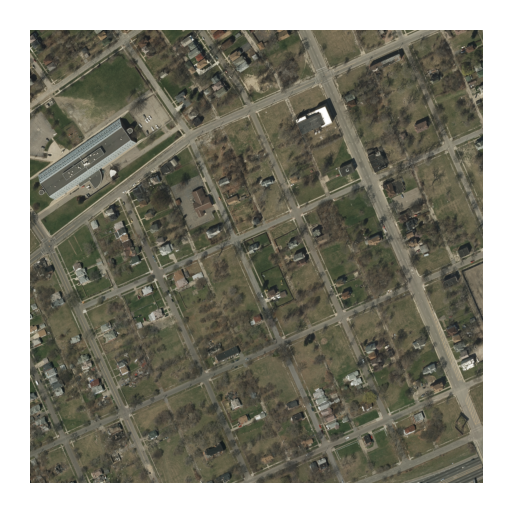

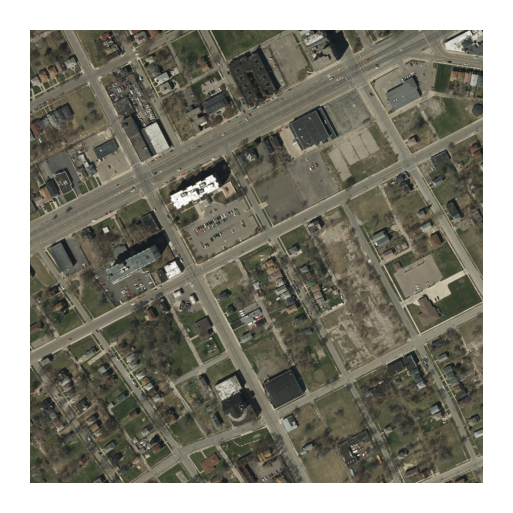

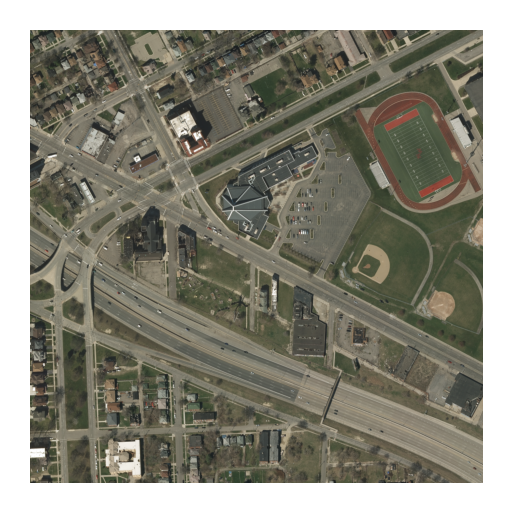

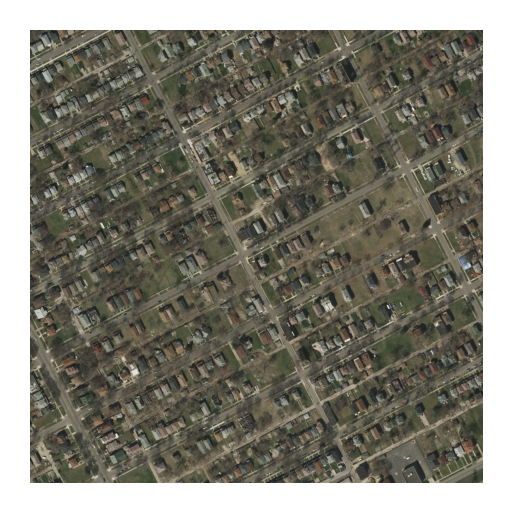

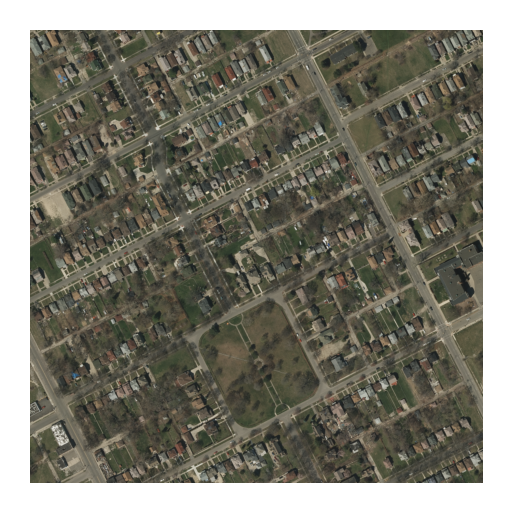

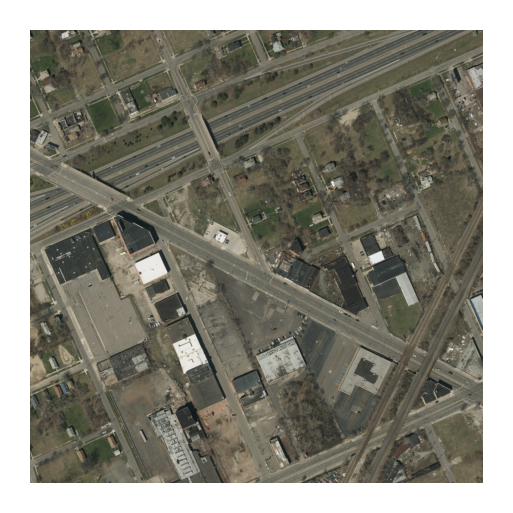

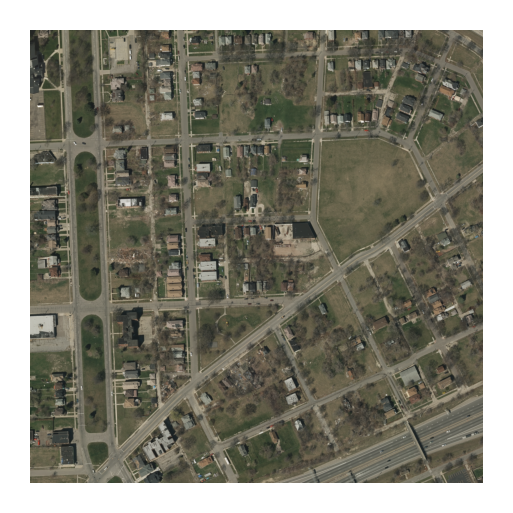

In [54]:
reload(extractor)

"""
Poorest median census tract
"""

LAT = 42.357425
LON = -83.099775
K = 10 # number of closest images

twelve_oaks_extract = extractor.Extractor()
results = twelve_oaks_extract.find_closest_latlon(lat=LAT, lon=LON, k=K)
# print(results.T)

for i, res in results.iterrows():
    res_tile = twelve_oaks_extract.tile_getter(res['county'], res['chunk_file'])

    print(res_tile.shape)

    img_to_chunk_index = int(str(res['image_index'])[1:]) 
    img = res_tile[img_to_chunk_index, :, :, :]
    twelve_oaks_extract.plot_image(img)
    county = str(res['county'])
    savepath = f'example_images/{i}_{county}.png'
    plt.savefig(savepath)